In [2]:
import pm4py

src_log = pm4py.read_xes("5_get_diagnostics.xes")

d:\Programs\Programming\Python\lib\site-packages\pm4py\util\dt_parsing\parser.py:82: UserWarning: ISO8601 strings are not fully supported with strpfromiso for Python versions below 3.11
  warnings.warn(


parsing log, completed traces ::   0%|          | 0/22 [00:00<?, ?it/s]

In [3]:
display(src_log["case:concept:name"].value_counts())
display(src_log["concept:name"].value_counts())

case:concept:name
5     52646
3     52444
17    33192
7     30652
1     25706
9     20246
13    19944
15    19116
11    18162
19    17576
21    17062
10      116
12      116
8       116
14      116
6       116
16      116
4       116
18      116
2       116
20      116
0       116
Name: count, dtype: int64

concept:name
Start:SyntaxNode.get_Green                                       6322
End:SyntaxNode.get_Green                                         6322
End:GreenNode.get_RawKind                                        4492
Start:GreenNode.get_RawKind                                      4492
End:GreenNode+NodeFlagsAndSlotCount.get_SmallSlotCount           3224
                                                                 ... 
End:CSharp.Syntax.InternalSyntax.SimpleBaseTypeSyntax.GetSlot       1
Start:CSharp.Syntax.InternalSyntax.BaseListSyntax.CreateRed         1
Start:CSharp.Syntax.BaseListSyntax..ctor                            1
End:CSharp.Syntax.BaseListSyntax..ctor                              1
End:CSharp.Syntax.ClassDeclarationSyntax.get_Keyword                1
Name: count, Length: 3796, dtype: int64

In [4]:
import tqdm

src_log_list = []
for row in tqdm.tqdm(src_log.iterrows(), total = len(src_log)):
    src_log_list.append(row[1].to_dict())
len(src_log_list)

100%|██████████| 308022/308022 [00:11<00:00, 26435.88it/s]


308022

In [5]:
import pandas

from utils.merge_paired_events import merge_paired_events
from utils.find_first_deviation import find_first_deviation
from utils.remove_call_contents import remove_call_contents
from utils.extract_call_contents import extract_call_contents
from utils.remove_package import remove_package

In [6]:
import typing

def display_process(log_list: typing.List[dict], event_to_remove: str, save_log_to: typing.Optional[str] = None, do_draw: bool = True):
    log_extracted = pandas.DataFrame(extract_call_contents(log_list, event_to_remove))
    if save_log_to:
        pm4py.write_xes(log_extracted, save_log_to)
    display(log_extracted.shape)
    display(log_extracted["case:concept:name"].value_counts())
    display(log_extracted["concept:name"].value_counts())
    
    if do_draw:
        log_extracted_merged = merge_paired_events(log_extracted)
        heuristics_net = pm4py.discover_heuristics_net(log_extracted_merged)
        return pm4py.view_heuristics_net(heuristics_net)

In [7]:
find_first_deviation(src_log_list)

100%|██████████| 308022/308022 [00:00<00:00, 4217567.43it/s]

Deviation: {'Start:CSharp.BindingDiagnosticBag..cctor': 11, 'End:CSharp.BindingDiagnosticBag.GetInstance': 11}


{'text': ['Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Start:CSharp.BindingDiagnosticBag..ccto

In [8]:
to_remove = 'CSharp.BindingDiagnosticBag..cctor'
log_list_1 = remove_call_contents(src_log_list, to_remove)
print(len(log_list_1))
display_process(src_log_list, to_remove)

100%|██████████| 308022/308022 [00:00<00:00, 3709906.69it/s]


307901


100%|██████████| 308022/308022 [00:00<00:00, 4466586.83it/s]


(132, 9)

case:concept:name
0     12
1     12
2     12
3     12
4     12
5     12
6     12
7     12
8     12
9     12
10    12
Name: count, dtype: int64

concept:name
Start:CSharp.BindingDiagnosticBag..cctor        11
Start:CSharp.BindingDiagnosticBag+<>c..cctor    11
Start:CSharp.BindingDiagnosticBag+<>c..ctor     11
End:CSharp.BindingDiagnosticBag+<>c..ctor       11
End:CSharp.BindingDiagnosticBag+<>c..cctor      11
Start:CSharp.BindingDiagnosticBag..ctor         11
Start:BindingDiagnosticBag`1                    11
Start:BindingDiagnosticBag..ctor                11
End:BindingDiagnosticBag..ctor                  11
End:BindingDiagnosticBag`1                      11
End:CSharp.BindingDiagnosticBag..ctor           11
End:CSharp.BindingDiagnosticBag..cctor          11
Name: count, dtype: int64

 82%|████████▏ | 9/11 [00:00<00:00, 8994.22it/s]


100%|██████████| 307901/307901 [00:00<00:00, 3207407.10it/s]


306857


100%|██████████| 307901/307901 [00:00<00:00, 3755326.21it/s]


(1058, 9)

case:concept:name
2     132
3     108
5     106
7      98
8      90
9      90
10     90
12     90
13     90
11     76
1      44
4      20
0      12
6      12
Name: count, dtype: int64

concept:name
Start:DiagnosticInfo.get_Severity                                                  142
End:DiagnosticInfo.get_Severity                                                    142
End:DiagnosticWithInfo.get_Severity                                                 71
End:DiagnosticWithInfo.get_Info                                                     71
Start:DiagnosticWithInfo.get_Severity                                               71
Start:DiagnosticWithInfo.get_Info                                                   71
End:CSharp.CSDiagnosticInfo..ctor                                                   28
Start:CSharp.CSDiagnosticInfo..ctor                                                 28
End:CSharp.MessageProvider.GetSeverity                                              14
Start:CSharp.MessageProvider.GetSeverity                                            14
Start:CSharp.ErrorFacts.GetSeverity                                                 14
Start:DiagnosticBag.get_Bag   

100%|█████████▉| 542/544 [00:00<00:00, 135461.37it/s]


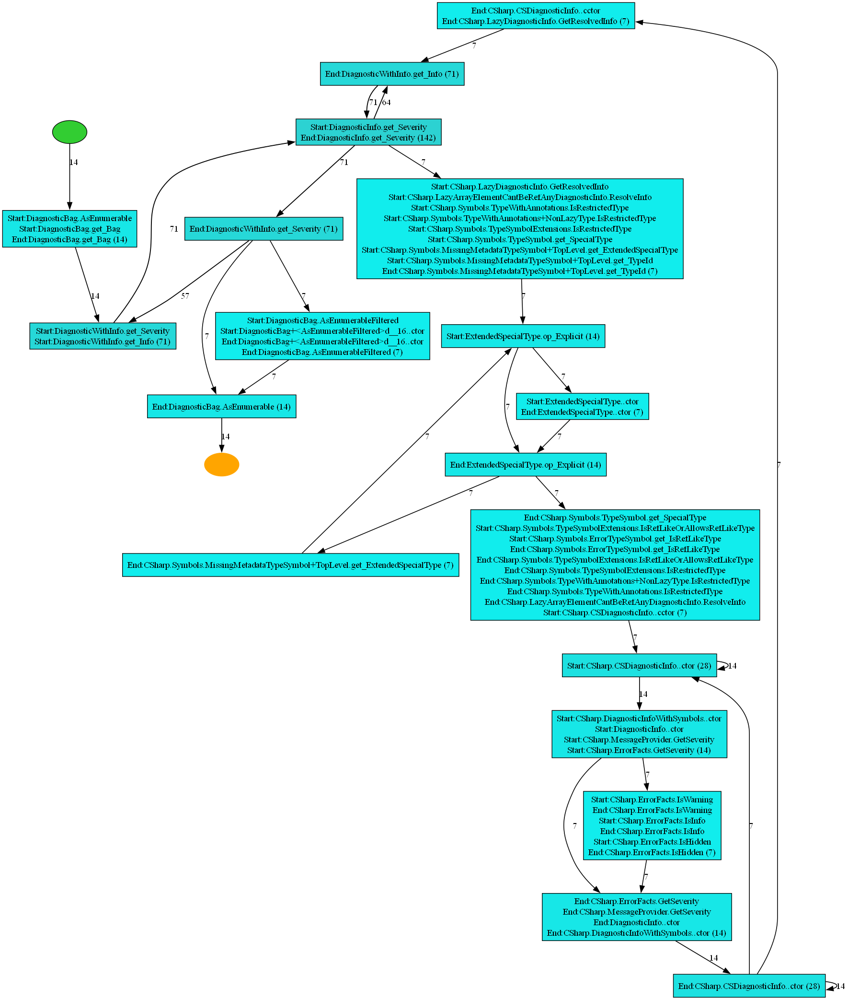

In [9]:
to_remove = 'DiagnosticBag.AsEnumerable'
log_list_1_5 = remove_call_contents(log_list_1, to_remove)
print(len(log_list_1_5))
display_process(log_list_1, to_remove)

In [10]:
find_first_deviation(log_list_1_5)

100%|██████████| 306857/306857 [00:00<00:00, 4580124.20it/s]

Deviation: {'Call:CSharp.BindingDiagnosticBag..cctor': 11, 'End:CSharp.BindingDiagnosticBag.GetInstance': 11}


{'text': ['Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:CSharp.BindingDiagnosticBag.GetInstance',
  'Call:CSharp.BindingDiagnosticBag..cctor',
  'End:

100%|██████████| 306857/306857 [00:00<00:00, 3652888.82it/s]


306412


100%|██████████| 306857/306857 [00:00<00:00, 4144786.51it/s]


(476, 9)

case:concept:name
0     36
8     36
20    36
14    36
23    36
11    36
25    36
5     36
28    36
3     36
17    36
26     4
27     4
19     4
24     4
22     4
21     4
29     4
15     4
18     4
16     4
1      4
13     4
12     4
10     4
9      4
7      4
6      4
4      4
2      4
30     4
Name: count, dtype: int64

concept:name
Start:CSharp.CSharpCompilation.get_SyntaxTrees                                    31
Start:CSharp.SyntaxAndDeclarationManager.GetLazyState                             31
End:CSharp.SyntaxAndDeclarationManager.GetLazyState                               31
End:CSharp.CSharpCompilation.get_SyntaxTrees                                      31
Start:CSharp.DeclarationTable..ctor                                               22
End:CSharp.DeclarationTable..ctor                                                 22
Start:ParseOptions.get_Kind                                                       11
Start:CSharp.SyntaxAndDeclarationManager.CreateState                              11
End:CSharp.SyntaxAndDeclarationManager.CreateState                                11
End:CSharp.SyntaxAndDeclarationManager+State..ctor                                11
Start:CSharp.SyntaxAndDeclarationManager+State..ctor                              11
End:CSharp.SyntaxAndDeclarationManager.AppendAllSynt

 99%|█████████▊| 148/150 [00:00<00:00, 74023.01it/s]


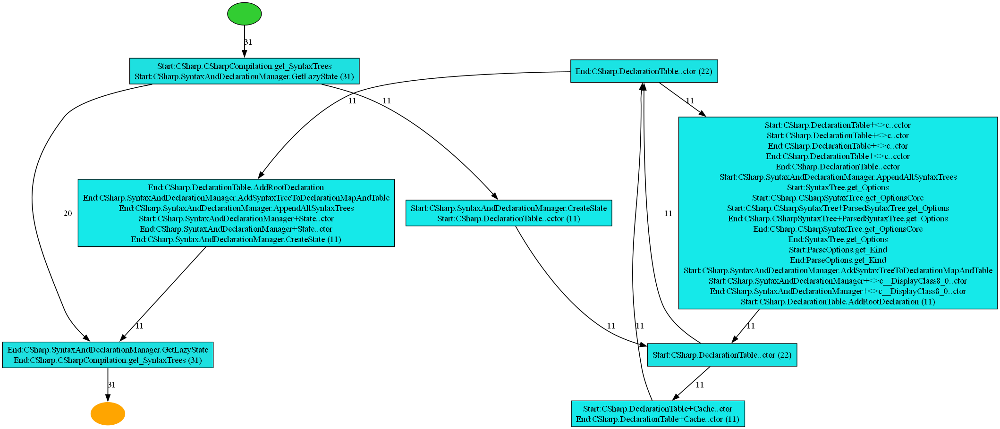

In [11]:
to_remove = 'CSharp.CSharpCompilation.get_SyntaxTrees'
log_list_2 = remove_call_contents(log_list_1_5, to_remove)
print(len(log_list_2))
display_process(log_list_1_5, to_remove)

In [12]:
to_remove = 'Compilation.CheckAssemblyName'
log_list_3 = remove_call_contents(log_list_2, to_remove)
print(len(log_list_3))
display_process(log_list_2, to_remove)

100%|██████████| 306412/306412 [00:00<00:00, 3404626.12it/s]


306379


100%|██████████| 306412/306412 [00:00<00:00, 3782837.74it/s]


(44, 9)

case:concept:name
0     4
1     4
2     4
3     4
4     4
5     4
6     4
7     4
8     4
9     4
10    4
Name: count, dtype: int64

concept:name
Start:Compilation.CheckAssemblyName    11
Start:Compilation.get_AssemblyName     11
End:Compilation.get_AssemblyName       11
End:Compilation.CheckAssemblyName      11
Name: count, dtype: int64

 82%|████████▏ | 9/11 [00:00<00:00, 3001.17it/s]


In [13]:
to_remove = 'CSharp.CSharpCompilation.GetBoundReferenceManager'
log_list_4 = remove_call_contents(log_list_3, to_remove)
print(len(log_list_4))
display_process(log_list_3, to_remove, do_draw = False)

100%|██████████| 306379/306379 [00:00<00:00, 3442405.86it/s]


270864


100%|██████████| 306379/306379 [00:00<00:00, 2974638.17it/s]


(36072, 9)

case:concept:name
152    6002
50     5978
426    4622
243    2712
0      2606
       ... 
181       2
180       2
179       2
178       2
556       2
Name: count, Length: 557, dtype: int64

concept:name
Start:SyntaxNode.get_Green                                           1733
End:SyntaxNode.get_Green                                             1733
End:CSharp.Syntax.InternalSyntax.ClassDeclarationSyntax.GetSlot      1086
Start:CSharp.Syntax.InternalSyntax.ClassDeclarationSyntax.GetSlot    1086
Start:SyntaxList`1                                                   1017
                                                                     ... 
End:Syntax.SyntaxList+WithTwoChildren..ctor                             1
End:Syntax.InternalSyntax.SyntaxList+WithTwoChildren.CreateRed          1
End:CSharp.Syntax.BaseListSyntax..ctor                                  1
Start:CSharp.Syntax.InternalSyntax.BaseListSyntax.CreateRed             1
Start:CSharp.Syntax.BaseListSyntax..ctor                                1
Name: count, Length: 616, dtype: int64

In [14]:
find_first_deviation([ event for event in log_list_4 if int(event['case:concept:name']) % 2 == 1])

100%|██████████| 270094/270094 [00:00<00:00, 4224159.98it/s]

Deviation: {'Start:CSharp.Symbols.SourceNamespaceSymbol.GetAliasesAndUsings': 3, 'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases': 8}


{'text': ['Start:CSharp.Symbols.SourceNamespaceSymbol.GetAliasesAndUsings',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.Symbols.SourceNamespaceSymbol.GetAliasesAndUsings',
  'Start:CSharp.Symbols.SourceNamespaceSymbol.GetAliasesAndUsings',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases',
  'Start:CSharp.RootSingleNamespaceDeclaration.get_HasExternAliases'],
 'traceids': ['1', '3', '5', '7', '9', '11', '13', '15', '17', '19', '21'],
 'open_events': ['Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:CSharp.CSharpCompilation.

In [15]:
to_remove = 'CSharp.Symbols.SourceNamespaceSymbol.ForceComplete'
log_list_5 = remove_call_contents(log_list_4, to_remove)
print(len(log_list_5))
display_process(log_list_4, to_remove, do_draw = False)

100%|██████████| 270864/270864 [00:00<00:00, 4106404.05it/s]


25431


100%|██████████| 270864/270864 [00:00<00:00, 752326.48it/s] 


(245444, 9)

case:concept:name
2     43755
1     43359
8     25988
3     25578
0     20801
4     15619
6     15544
7     14836
5     13886
9     13296
10    12782
Name: count, dtype: int64

concept:name
Start:SyntaxNode.get_Green                                                4578
End:SyntaxNode.get_Green                                                  4578
Start:GreenNode.get_RawKind                                               3570
End:GreenNode.get_RawKind                                                 3570
Start:GreenNode+NodeFlagsAndSlotCount.get_SmallSlotCount                  2986
                                                                          ... 
End:CSharp.Syntax.InternalSyntax.SimpleBaseTypeSyntax.GetSlot                1
End:CSharp.Symbols.NamedTypeSymbol.get_KnownToHaveNoDeclaredBaseCycles       1
Start:CSharp.Syntax.SimpleBaseTypeSyntax.get_Type                            1
End:CSharp.Syntax.BaseListSyntax.get_Types                                   1
End:CSharp.WithTypeParametersBinder.LookupSymbolsInSingleBinder              1
Name: count, Length: 3087, dtype: int64

In [16]:
pandas.DataFrame(log_list_5)["concept:name"].value_counts()

concept:name
Start:CustomAttributesBag`1                                    957
End:CustomAttributesBag`1                                      957
Start:CSharp.CSharpCompilation.get_Options                     330
End:CSharp.CSharpCompilation.get_Options                       330
Start:CSharp.Symbols.SymbolCompletionState.NotePartComplete    319
                                                              ... 
End:CSharp.Symbols.NonMissingAssemblySymbol+<>c..cctor           4
Start:CSharp.Symbols.NamespaceExtent..ctor                       4
End:CSharp.Symbols.NamespaceExtent..ctor                         4
Start:CSharp.Symbols.MergedNamespaceSymbol.Create                4
End:CSharp.Symbols.MergedNamespaceSymbol.Create                  4
Name: count, Length: 662, dtype: int64

In [17]:
find_first_deviation([ event for event in log_list_5 if int(event['case:concept:name']) % 2 == 1])

100%|██████████| 24661/24661 [00:00<00:00, 4069389.05it/s]

Deviation: {'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace': 7, 'Start:CSharp.Symbols.SourceAssemblySymbol.get_Modules': 4}


{'text': ['End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'Start:CSharp.Symbols.SourceAssemblySymbol.get_Modules',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'Start:CSharp.Symbols.SourceAssemblySymbol.get_Modules',
  'End:CSharp.Symbols.NonMissingAssemblySymbol.get_GlobalNamespace',
  'Start:CSharp.Symbols.SourceAssemblySymbol.get_Modules',
  'Start:CSharp.Symbols.SourceAssemblySymbol.get_Modules'],
 'traceids': ['1', '3', '5', '7', '9', '11', '13', '15', '17', '19', '21'],
 'open_events': ['Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:CSharp.CSharpCompilation.GetDiagnosticsWithoutSeverityFiltering',
  'S

In [18]:
to_remove = 'CSharp.Symbols.SourceAssemblySymbol.ReportDiagnosticsForAddedModules'
log_list_6 = remove_call_contents(log_list_5, to_remove)
print(len(log_list_6))
display_process(log_list_5, to_remove, do_draw = False)

100%|██████████| 25431/25431 [00:00<00:00, 3633758.43it/s]


25171


100%|██████████| 25431/25431 [00:00<00:00, 4240829.56it/s]


(271, 9)

case:concept:name
5     31
7     31
9     31
10    31
0     21
1     21
2     21
3     21
4     21
6     21
8     21
Name: count, dtype: int64

concept:name
Start:CSharp.Symbols.SourceAssemblySymbol.ReportDiagnosticsForAddedModules                 11
Start:DiagnosticBag.get_IsEmptyWithoutResolution                                           11
End:CSharp.Symbols.SourceAssemblySymbol.ReportDiagnosticsForAddedModules                   11
End:CSharp.BindingDiagnosticBag.Free                                                       11
End:BindingDiagnosticBag`1                                                                 11
End:DiagnosticBag.Clear                                                                    11
Start:DiagnosticBag.Clear                                                                  11
Start:CSharp.BindingDiagnosticBag.GetInstance                                              11
Start:CSharp.BindingDiagnosticBag.Free                                                     11
End:CSharp.Symbol.AddDeclarationDiagnostics                                                11
End:DiagnosticBag.get_IsEmptyWithoutResolution 

In [19]:
pandas.DataFrame(log_list_6)["concept:name"].value_counts()

concept:name
End:CustomAttributesBag`1                                                        957
Start:CustomAttributesBag`1                                                      957
End:CSharp.CSharpCompilation.get_Options                                         330
Start:CSharp.CSharpCompilation.get_Options                                       330
Start:CSharp.Symbols.SymbolCompletionState.NotePartComplete                      319
                                                                                ... 
Start:CSharp.Symbols.SourceAssemblySymbol.get_AssemblyCultureAttributeSetting     11
End:CSharp.Symbols.SourceAssemblySymbol.get_AssemblyCultureAttributeSetting       11
Start:CSharp.Symbols.SourceAssemblySymbol.get_AssemblyFlags                       11
End:CSharp.Symbols.SourceAssemblySymbol.get_AssemblyFlags                         11
Start:CSharp.Symbol.get_IsDefinition                                              11
Name: count, Length: 651, dtype: int64

In [20]:
find_first_deviation([ event for event in log_list_6 if int(event['case:concept:name']) % 2 == 1])

100%|██████████| 24401/24401 [00:00<00:00, 3049073.82it/s]

Deviation: {'Start:DiagnosticInfo+<>c.<GetOrCreateDescriptor>b__12_0': 2, 'End:DiagnosticInfo.GetOrCreateDescriptor': 9}


{'text': ['Start:DiagnosticInfo+<>c.<GetOrCreateDescriptor>b__12_0',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'Start:DiagnosticInfo+<>c.<GetOrCreateDescriptor>b__12_0',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor',
  'End:DiagnosticInfo.GetOrCreateDescriptor'],
 'traceids': ['1', '3', '5', '7', '9', '11', '13', '15', '17', '19', '21'],
 'open_events': ['Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:CSharp.CSharpCompilation.GetDiagnostics',
  'Start:Compilation.FilterAndAppendDiagnostics',
  'Start:Compilation.FilterAndAppendDiagnostics',
  'Start:CSharp.CSharpCompilationOptions.FilterDiagnostic',
  'Start:CSharp.CSharpDiagnosticFilter.Filter',
  'Start:DiagnosticWithInfo.get_IsEnabledByDefault',
 

100%|██████████| 25171/25171 [00:00<00:00, 3596975.43it/s]


19437


100%|██████████| 25171/25171 [00:00<00:00, 3147541.17it/s]


(5756, 9)

case:concept:name
3     1144
5      958
17     710
1      462
7      462
13     400
9      400
11     272
19     272
15     272
21     272
10      12
12      12
8       12
14      12
6       12
16      12
4       12
18      12
2       12
20      12
0       12
Name: count, dtype: int64

concept:name
End:DiagnosticInfo.get_Severity                272
End:DiagnosticWithInfo.get_Info                272
Start:DiagnosticInfo.get_Severity              272
Start:DiagnosticWithInfo.get_Info              272
Start:DiagnosticWithInfo.IsNotConfigurable     136
                                              ... 
Start:DiagnosticInfo+<>c..ctor                  11
Start:DiagnosticInfo+<>c..cctor                 11
End:DiagnosticInfo..cctor                       11
Start:DiagnosticInfo..cctor                     11
Start:CSharp.ErrorFacts.CreateCategoriesMap     11
Name: count, Length: 104, dtype: int64

100%|█████████▉| 1712/1714 [00:00<00:00, 53501.09it/s]


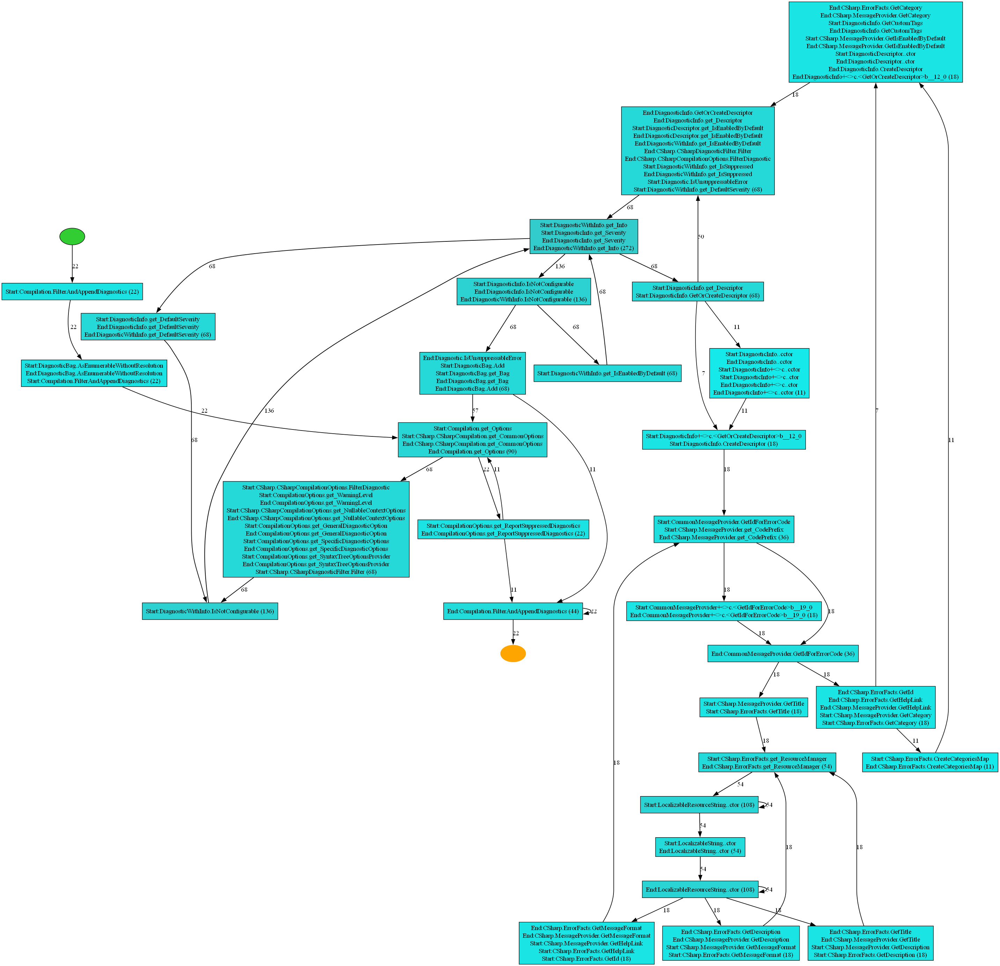

In [21]:
to_remove = 'Compilation.FilterAndAppendDiagnostics'
log_list_7 = remove_call_contents(log_list_6, to_remove)
print(len(log_list_7))
display_process(log_list_6, to_remove, do_draw = True)

In [22]:
find_first_deviation([ event for event in log_list_7 if int(event['case:concept:name']) % 2 == 1])

100%|██████████| 18788/18788 [00:00<00:00, 4697340.46it/s]


In [23]:
pm4py.view_heuristics_net(pm4py.discover_heuristics_net(merge_paired_events(pandas.DataFrame(log_list_7))))

100%|█████████▉| 11713/11715 [00:00<00:00, 64711.86it/s]


In [39]:
to_remove = 'CSharp.Symbols.SourceAssemblySymbol.ForceComplete'
log_list_7_1 = remove_call_contents(log_list_7, to_remove)
print(len(log_list_7_1))
display_process(log_list_7, to_remove, do_draw = True)

100%|██████████| 19437/19437 [00:00<00:00, 3239219.92it/s]


5148


100%|██████████| 19437/19437 [00:00<00:00, 1495399.36it/s]


(14300, 9)

case:concept:name
0     1300
1     1300
2     1300
3     1300
4     1300
5     1300
6     1300
7     1300
8     1300
9     1300
10    1300
Name: count, dtype: int64

concept:name
Start:CustomAttributesBag`1                                    814
End:CustomAttributesBag`1                                      814
Start:CSharp.Symbols.SymbolCompletionState.NotePartComplete    286
End:CSharp.Symbols.SymbolCompletionState.NotePartComplete      286
Start:CSharp.Symbols.SymbolCompletionState.HasComplete         264
                                                              ... 
Start:CSharp.Symbols.SourceNamespaceSymbol+<>c..ctor            11
End:CSharp.Symbols.SourceNamespaceSymbol+<>c..ctor              11
End:CSharp.Symbols.SourceNamespaceSymbol+<>c..cctor             11
End:CSharp.Symbols.SourceNamespaceSymbol..cctor                 11
End:CSharp.Symbols.SourceAssemblySymbol.ForceComplete           11
Name: count, Length: 389, dtype: int64

100%|█████████▉| 8226/8228 [00:00<00:00, 77604.69it/s]


100%|█████████▉| 2924/2926 [00:00<00:00, 139246.61it/s]


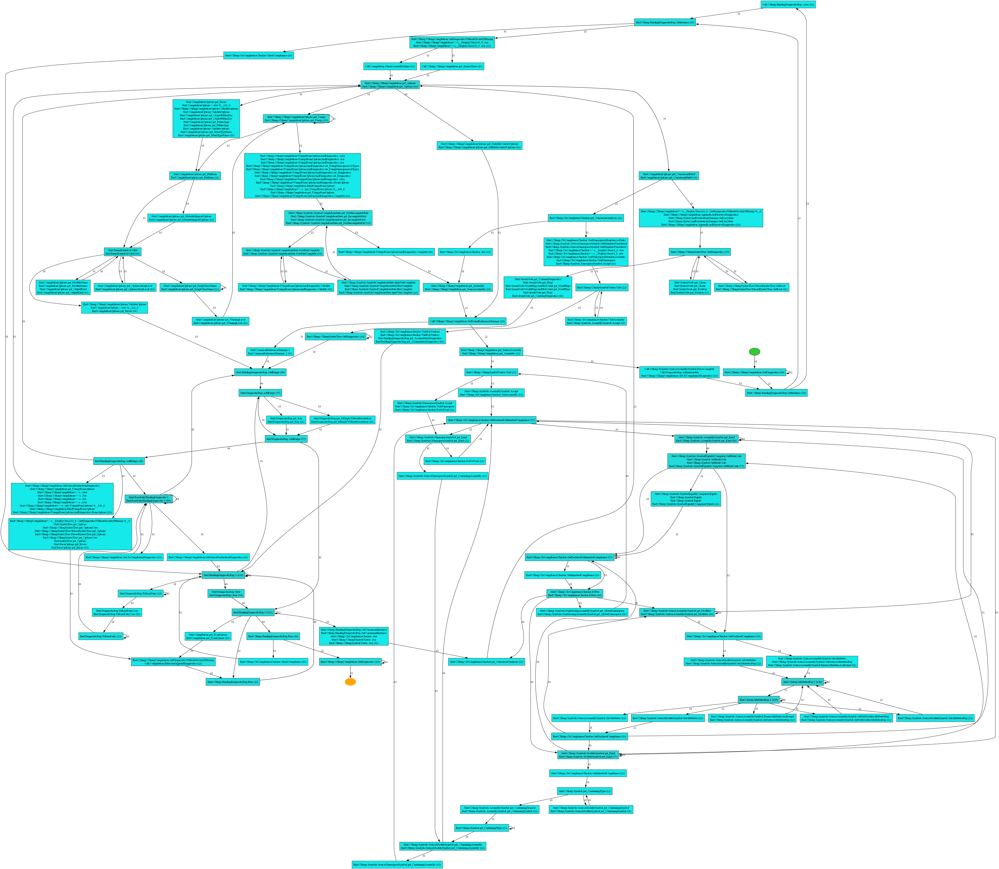

In [34]:
pm4py.view_heuristics_net(pm4py.discover_heuristics_net(merge_paired_events(pandas.DataFrame(log_list_7_1))))

100%|██████████| 5148/5148 [00:00<00:00, 5147145.89it/s]


2464


100%|██████████| 5148/5148 [00:00<00:00, 1287400.25it/s]


(2695, 9)

case:concept:name
0     245
1     245
2     245
3     245
4     245
5     245
6     245
7     245
8     245
9     245
10    245
Name: count, dtype: int64

concept:name
Start:CustomAttributesBag`1                                            143
End:CustomAttributesBag`1                                              143
Start:BindingDiagnosticBag`1                                            88
End:BindingDiagnosticBag`1                                              88
End:CSharp.Symbols.AssemblySymbol.get_Kind                              88
                                                                      ... 
End:CSharp.Symbols.SourceAssemblySymbol.GetAttributes                   11
End:CSharp.Symbols.SourceAssemblySymbol.GetNetModuleAttributesBag       11
Start:CSharp.Symbols.SourceAssemblySymbol.GetNetModuleAttributesBag     11
End:CSharp.Symbols.SourceAssemblySymbol.GetSourceAttributesBag          11
End:CSharp.CSharpCompilation.GetClsComplianceDiagnostics                11
Name: count, Length: 111, dtype: int64

100%|█████████▉| 1582/1584 [00:00<00:00, 175753.27it/s]


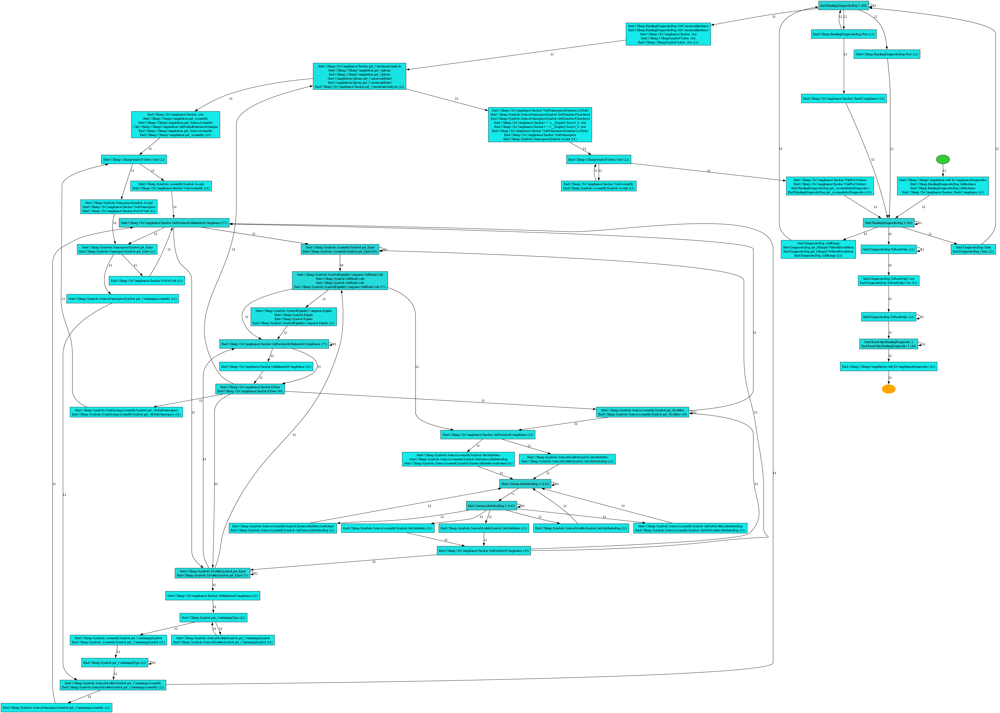

In [57]:
to_remove = 'CSharp.CSharpCompilation.GetClsComplianceDiagnostics'
log_list_7_2 = remove_call_contents(log_list_7_1, to_remove)
print(len(log_list_7_2))
display_process(log_list_7_1, to_remove, do_draw = True)

In [71]:
log_list_8 = remove_package(log_list_7_2, "CSharp.CSharpCompilationOptions")
log_list_8 = remove_package(log_list_8, "CompilationOptions")
log_list_8 = remove_package(log_list_8, "CSharp.CSharpCommandLineArguments")
log_list_8 = remove_package(log_list_8, "CommandLineArguments")
log_list_8 = remove_package(log_list_8, "CSharp.CSharpParseOptions")
log_list_8 = remove_package(log_list_8, "ParseOptions")
log_list_8 = remove_call_contents(log_list_8, "CSharp.CSharpCompilation.get_Options", keep_call = False)
log_list_8 = remove_call_contents(log_list_8, "CSharp.BindingDiagnosticBag.GetInstance", keep_call = False)
log_list_8 = remove_call_contents(log_list_8, "BindingDiagnosticBag`1", keep_call = False)
len(log_list_8)

1/3: Start:CSharp.CSharpCompilationOptions.ValidateOptions


100%|██████████| 2464/2464 [00:00<00:00, 2465942.51it/s]


2/3: Start:CSharp.CSharpCompilationOptions.get_Usings


100%|██████████| 2024/2024 [00:00<00:00, 2026079.07it/s]


3/3: Start:CSharp.CSharpCompilationOptions.get_NullableContextOptions


100%|██████████| 2002/2002 [00:00<00:00, 2001190.80it/s]


1/3: Start:CompilationOptions.get_ConcurrentBuild


100%|██████████| 1980/1980 [00:00<00:00, 989835.75it/s]


2/3: Start:CompilationOptions.get_Errors


100%|██████████| 1958/1958 [00:00<00:00, 1957675.14it/s]


3/3: Start:CompilationOptions.<.ctor>b__121_0


100%|██████████| 1914/1914 [00:00<00:00, 1918255.16it/s]


1/1: Start:ParseOptions.get_Errors


100%|██████████| 1749/1749 [00:00<00:00, 1741651.87it/s]


1507

100%|█████████▉| 504/506 [00:00<00:00, 83996.07it/s]


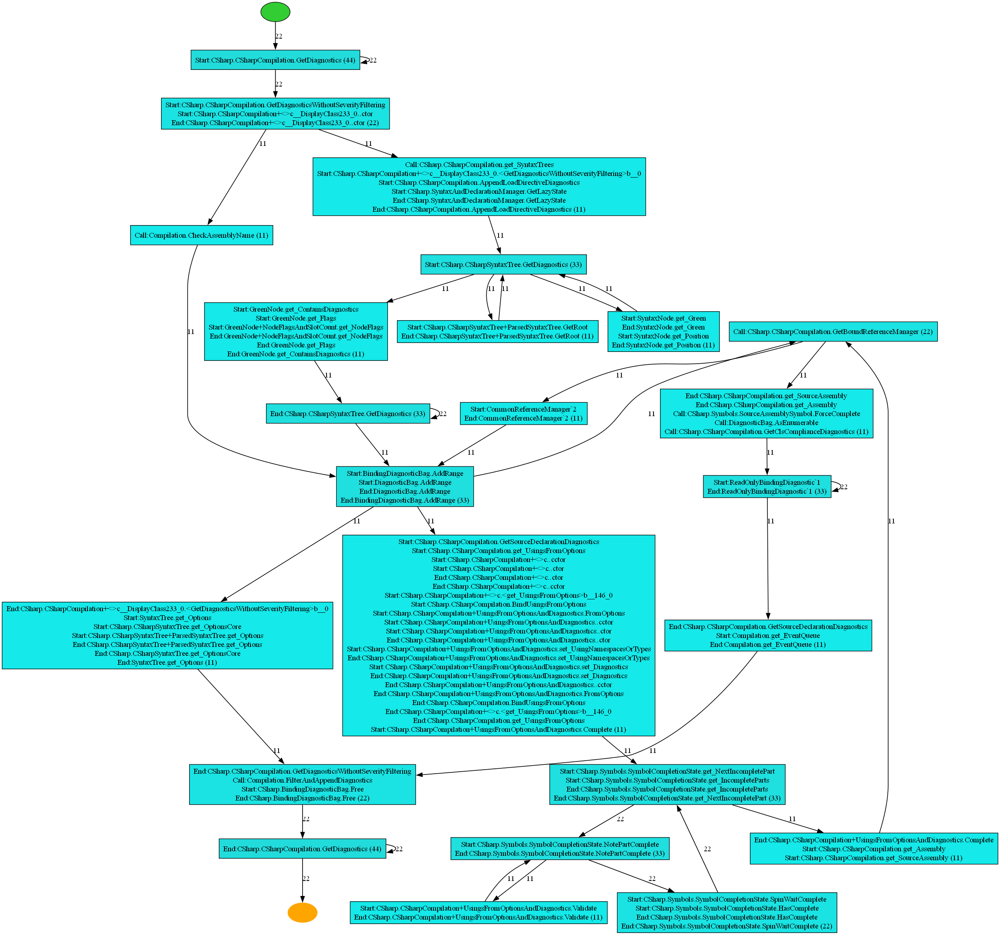

In [72]:
pm4py.view_heuristics_net(pm4py.discover_heuristics_net(merge_paired_events(pandas.DataFrame(log_list_8))))